In [1]:
import os
import h5py
import pickle
import numpy as np
from tqdm.auto import trange

In [41]:
from provabgs import infer as Infer

In [2]:
# torch
import torch
from torch.utils.tensorboard.writer import SummaryWriter

from sbi import utils as Ut
from sbi import inference as Inference

In [3]:
# --- plotting --- 
import corner as DFM
import matplotlib as mpl
import matplotlib.pyplot as plt
#mpl.use('PDF')
#mpl.rcParams['text.usetex'] = True
mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['axes.linewidth'] = 1.5
mpl.rcParams['axes.xmargin'] = 1
mpl.rcParams['xtick.labelsize'] = 'x-large'
mpl.rcParams['xtick.major.size'] = 5
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['ytick.labelsize'] = 'x-large'
mpl.rcParams['ytick.major.size'] = 5
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['legend.frameon'] = False

In [4]:
if torch.cuda.is_available(): device = 'cuda'
else: device = 'cpu'

In [5]:
# load training data 
dat_dir = '/scratch/network/chhahn/sedflow/'

train_theta = np.load(os.path.join(dat_dir, 'sedflow_p.train.v0.3.theta_unt.npy'))
train_Ahspec = np.load(os.path.join(dat_dir, 'sedflow_p.train.v0.3.Ah_spec.npy'))
train_Ahivar = np.load(os.path.join(dat_dir, 'sedflow_p.train.v0.3.Ah_ivar.npy'))
train_zred = np.load(os.path.join(dat_dir, 'sedflow_p.train.v0.3.zred.npy'))

In [6]:
# clean data
pos_Aspec = (train_Ahspec[:,0] > 0)

train_theta = train_theta[pos_Aspec]
train_Ahspec = train_Ahspec[pos_Aspec]
train_Ahivar = train_Ahivar[pos_Aspec]
train_zred = train_zred[pos_Aspec]

In [7]:
train_theta[:,6:8] = np.log10(train_theta[:,6:8])
# log10 of normalization
train_Ahspec[:,0] = np.log10(train_Ahspec[:,0])
train_Ahivar[:,0] = np.log10(train_Ahivar[:,0])

In [8]:
x_train = np.concatenate([train_Ahspec, train_Ahivar, train_zred[:,None]], axis=1)

In [9]:
print('Ntrain = %i' % train_theta.shape[0])

Ntrain = 986303


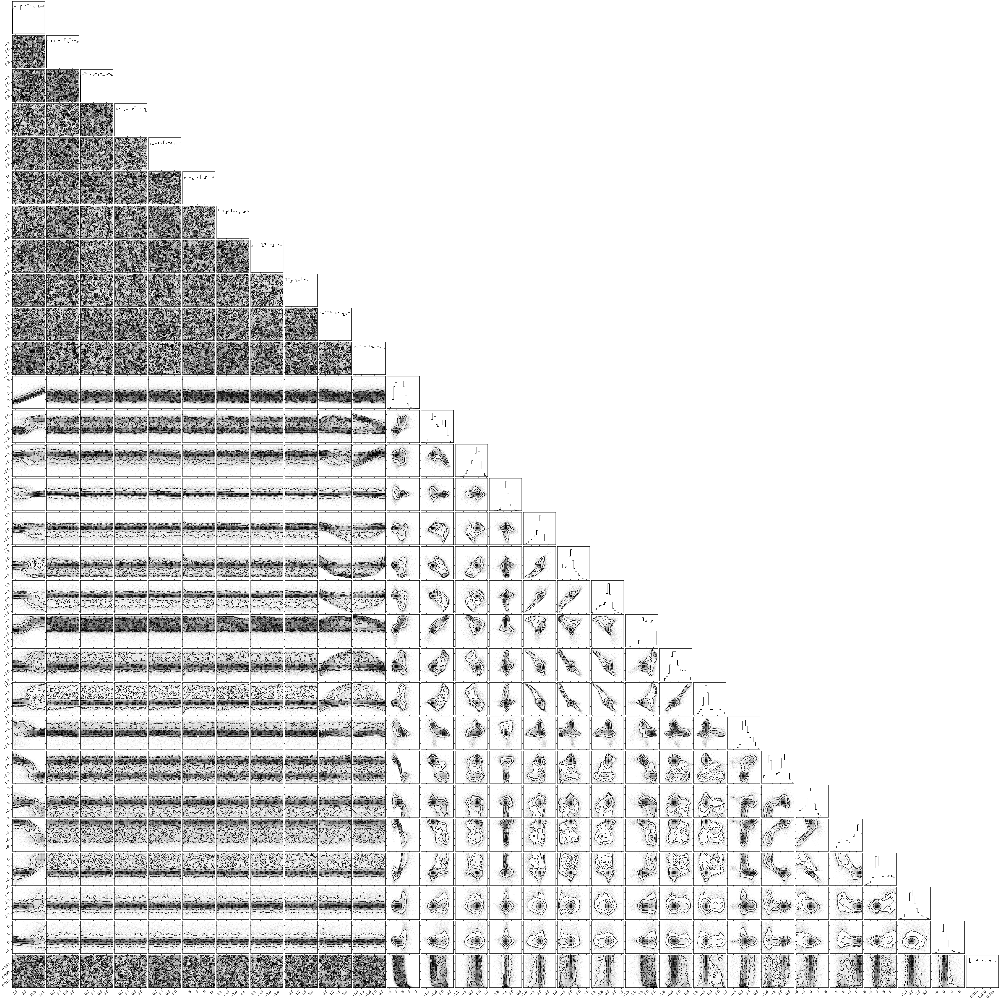

In [10]:
fig = DFM.corner(np.concatenate([train_theta, x_train], axis=1)[::100])

In [11]:
# set prior
prior_low   = [7, 0., 0., 0., 0., 1e-2, np.log10(4.5e-5), np.log10(4.5e-5), 0, 0., -2.]
prior_high  = [12.5, 1., 1., 1., 1., 13.27, np.log10(1.5e-2), np.log10(1.5e-2), 3., 3., 1.]
lower_bounds = torch.tensor(prior_low).to(device)
upper_bounds = torch.tensor(prior_high).to(device)
prior = Ut.BoxUniform(low=lower_bounds, high=upper_bounds, device=device)

/home/chhahn/.conda/envs/torch-env/lib/python3.7/site-packages/sbi/utils/torchutils.py:28: UserWarning: GPU was selected as a device for training the neural network. Note that we expect **no** significant speed ups in training for the default architectures we provide. Using the GPU will be effective only for large neural networks with operations that are fast on the GPU, e.g., for a CNN or RNN `embedding_net`.
  "GPU was selected as a device for training the neural network. "


In [12]:
n_hidden = 256
n_transf = 5
n_blocks = 2

fanpe = '/scratch/network/chhahn/sedflow/anpe/anpe.sedflow_p.v0.3.%ix%ix%i.pt' % (n_hidden, n_transf, n_blocks)

neural_posterior = Ut.posterior_nn('maf', 
                                   hidden_features=n_hidden, 
                                   num_transforms=n_transf, 
                                   num_blocks=n_blocks)
# train NPE
anpe = Inference.SNPE(
        prior=prior,
        density_estimator=neural_posterior,
        device=device,
        summary_writer=SummaryWriter(fanpe.replace('.pt', '')))

anpe.append_simulations(
    torch.as_tensor(train_theta[::10].astype(np.float32)).to(device),
    torch.as_tensor(x_train[::10].astype(np.float32)).to(device))

p_x_y_estimator = anpe.train(
    training_batch_size=256)
qphi = anpe.build_posterior(p_x_y_estimator)

# save trained ANPE
torch.save(qphi, fanpe)

# save training summary
print(anpe._summary['best_validation_log_probs'])
pickle.dump(anpe._summary, open(fanpe.replace('.pt', '.p'), 'wb'))

 Neural network successfully converged after 173 epochs.[-2.3868194065595927]


(0.0, 173.0)

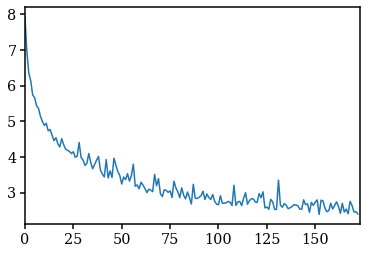

In [18]:
plt.plot(-np.array(anpe._summary['validation_log_probs']))
plt.xlim(0., len(anpe._summary['validation_log_probs']))

# validation

In [40]:
# load test data 
test_theta = np.load(os.path.join(dat_dir, 'sedflow_p.test.v0.3.theta_unt.npy'))
test_Ahspec = np.load(os.path.join(dat_dir, 'sedflow_p.test.v0.3.Ah_spec.npy'))
test_Ahivar = np.load(os.path.join(dat_dir, 'sedflow_p.test.v0.3.Ah_ivar.npy'))
test_zred = np.load(os.path.join(dat_dir, 'sedflow_p.test.v0.3.zred.npy'))

# clean data
pos_Aspec = (test_Ahspec[:,0] > 0)

test_theta[:,6:8] = np.log10(test_theta[:,6:8])
# log10 of normalization
test_Ahspec[:,0] = np.log10(test_Ahspec[:,0])
test_Ahivar[:,0] = np.log10(test_Ahivar[:,0])

x_test = np.concatenate([test_Ahspec, test_Ahivar, test_zred[:,None]], axis=1)

/home/chhahn/.conda/envs/torch-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in log10
  if sys.path[0] == '':


In [42]:
prior_sps = Infer.load_priors([
        Infer.UniformPrior(7., 12.5, label='sed'),
        Infer.FlatDirichletPrior(4, label='sed'),           # flat dirichilet priors
        Infer.UniformPrior(0., 1., label='sed'),            # burst fraction
        Infer.UniformPrior(1e-2, 13.27, label='sed'),    # tburst
        Infer.LogUniformPrior(4.5e-5, 1.5e-2, label='sed'), # log uniform priors on ZH coeff
        Infer.LogUniformPrior(4.5e-5, 1.5e-2, label='sed'), # log uniform priors on ZH coeff
        Infer.UniformPrior(0., 3., label='sed'),        # uniform priors on dust1
        Infer.UniformPrior(0., 3., label='sed'),        # uniform priors on dust2
        Infer.UniformPrior(-2., 1., label='sed')     # uniform priors on dust_index
    ])

In [46]:
fmcmc = h5py.File(f'/scratch/network/chhahn/sedflow/mcmc_spectra/mcmc.mock.0.hdf5', 'r')

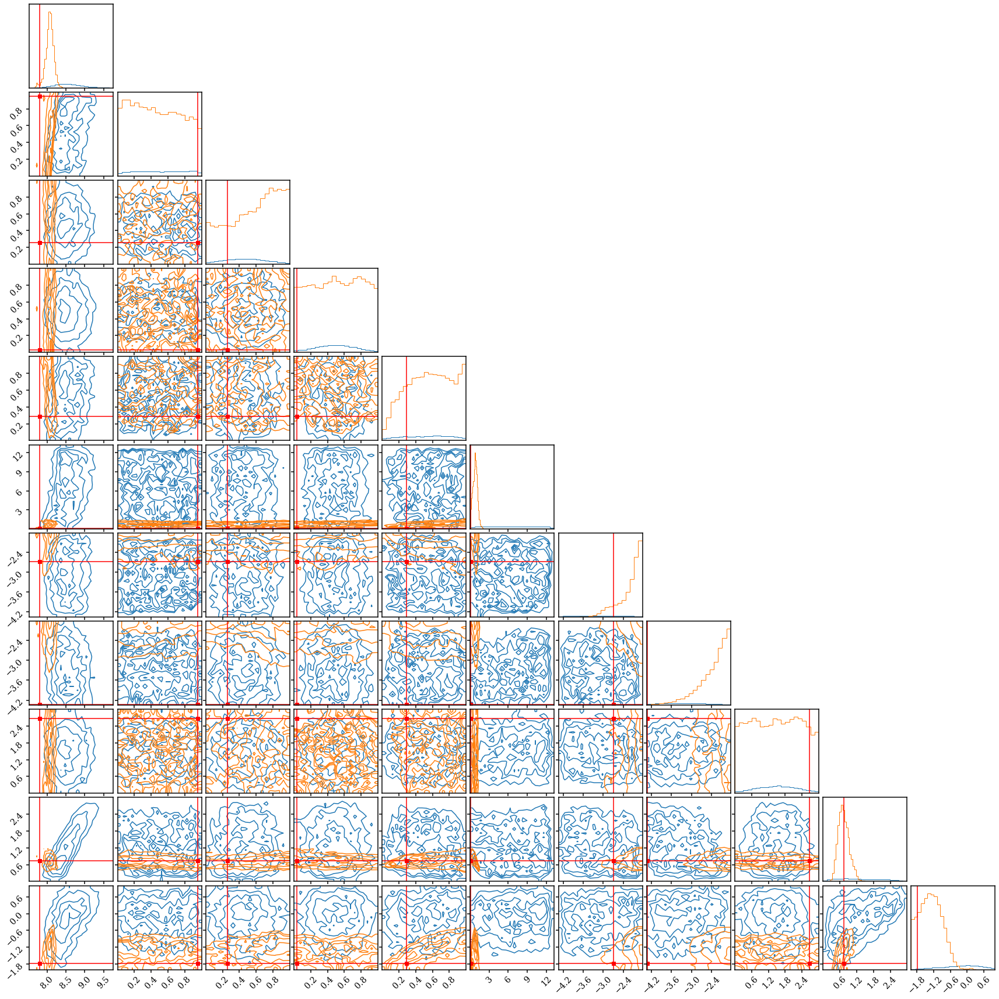

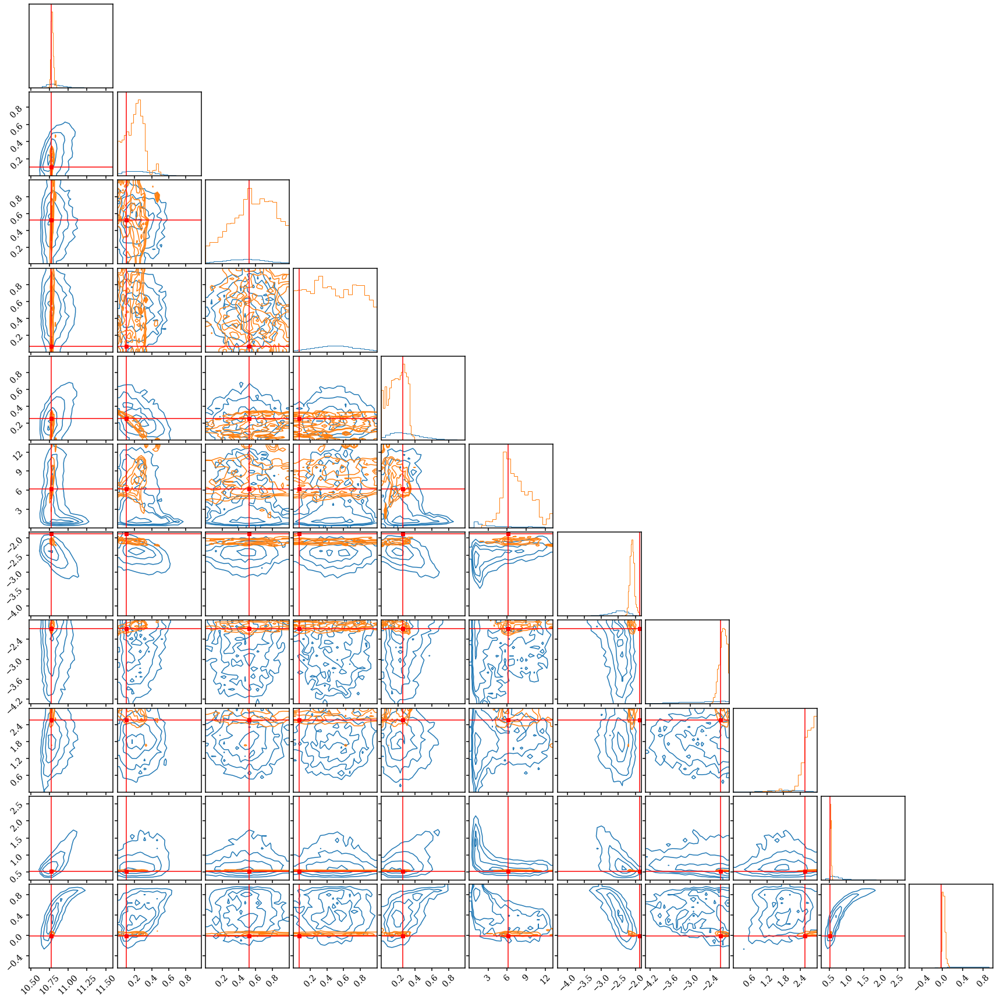

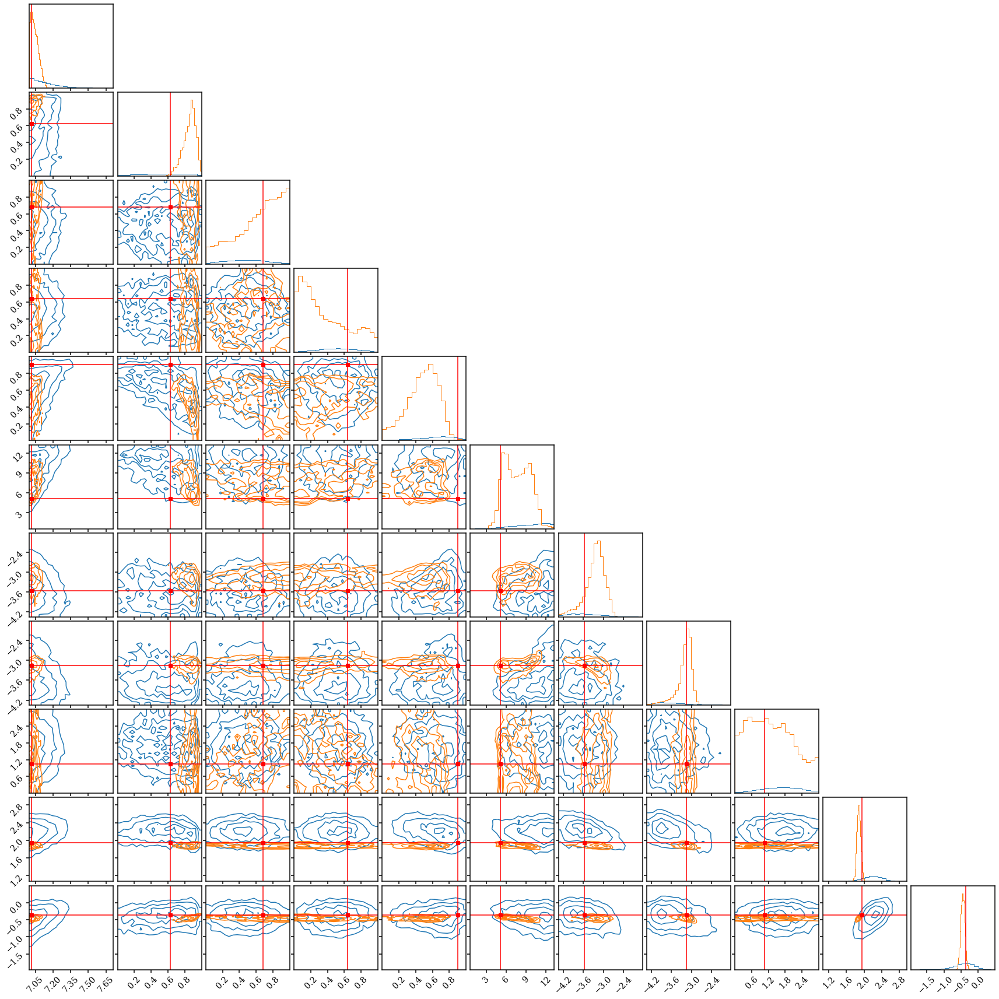

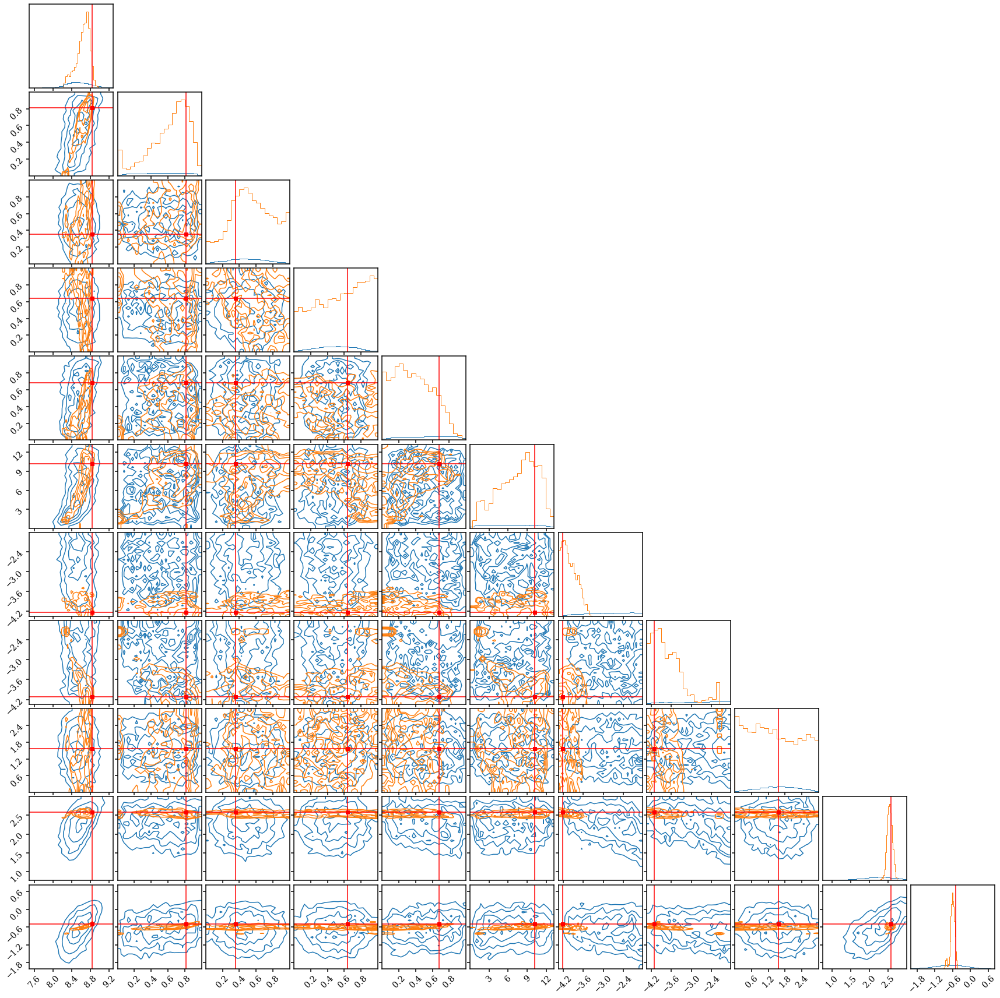

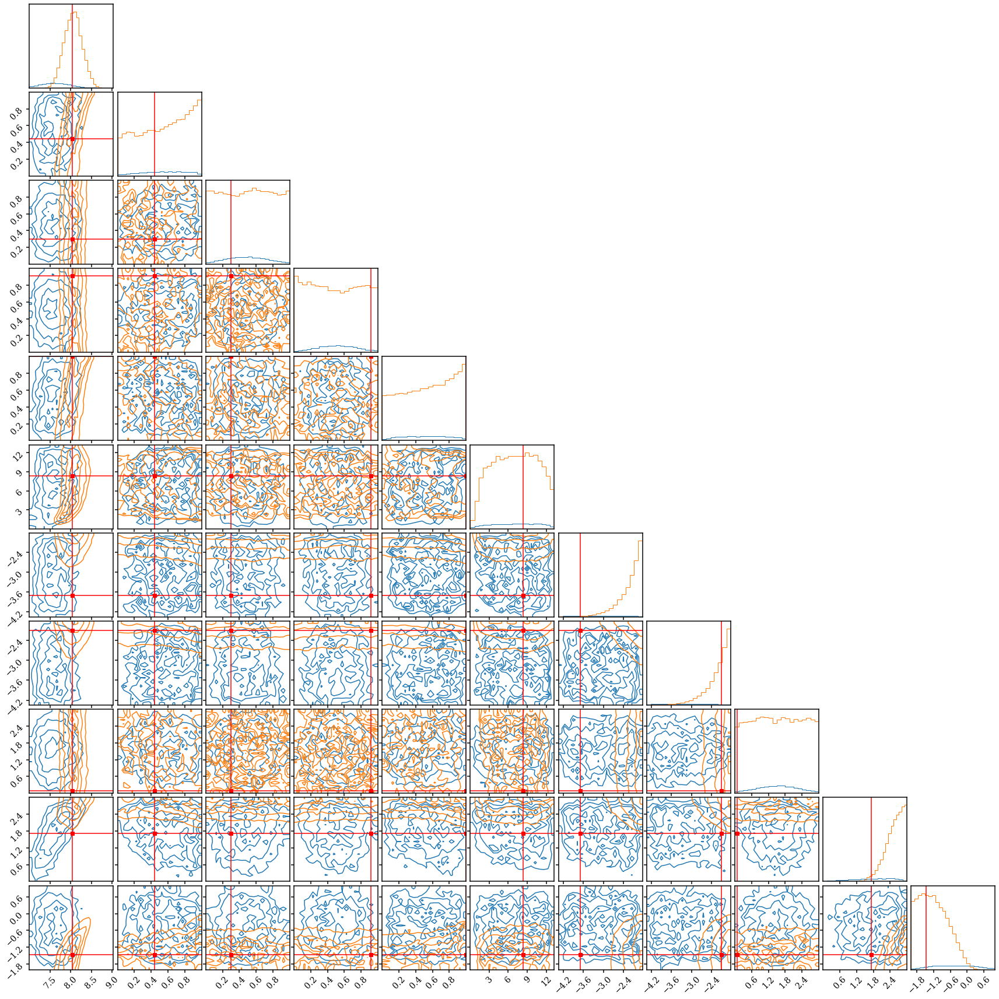

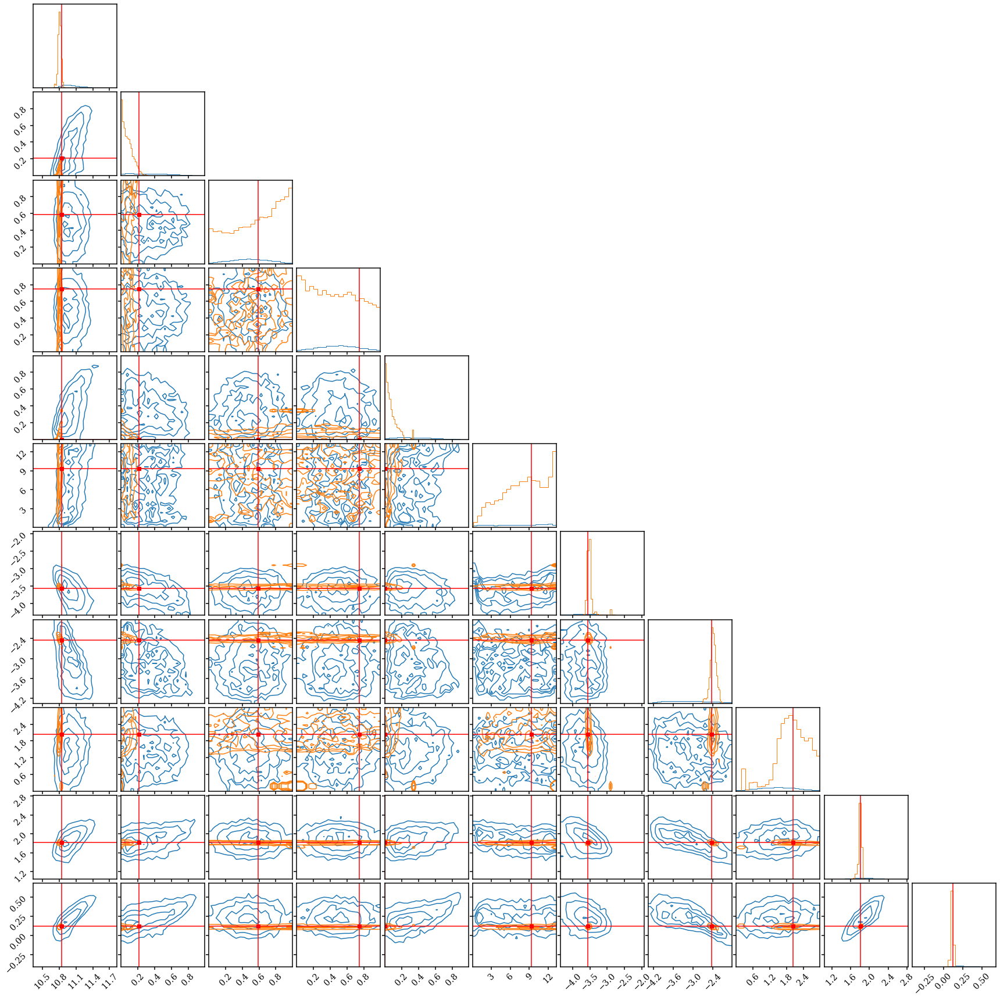

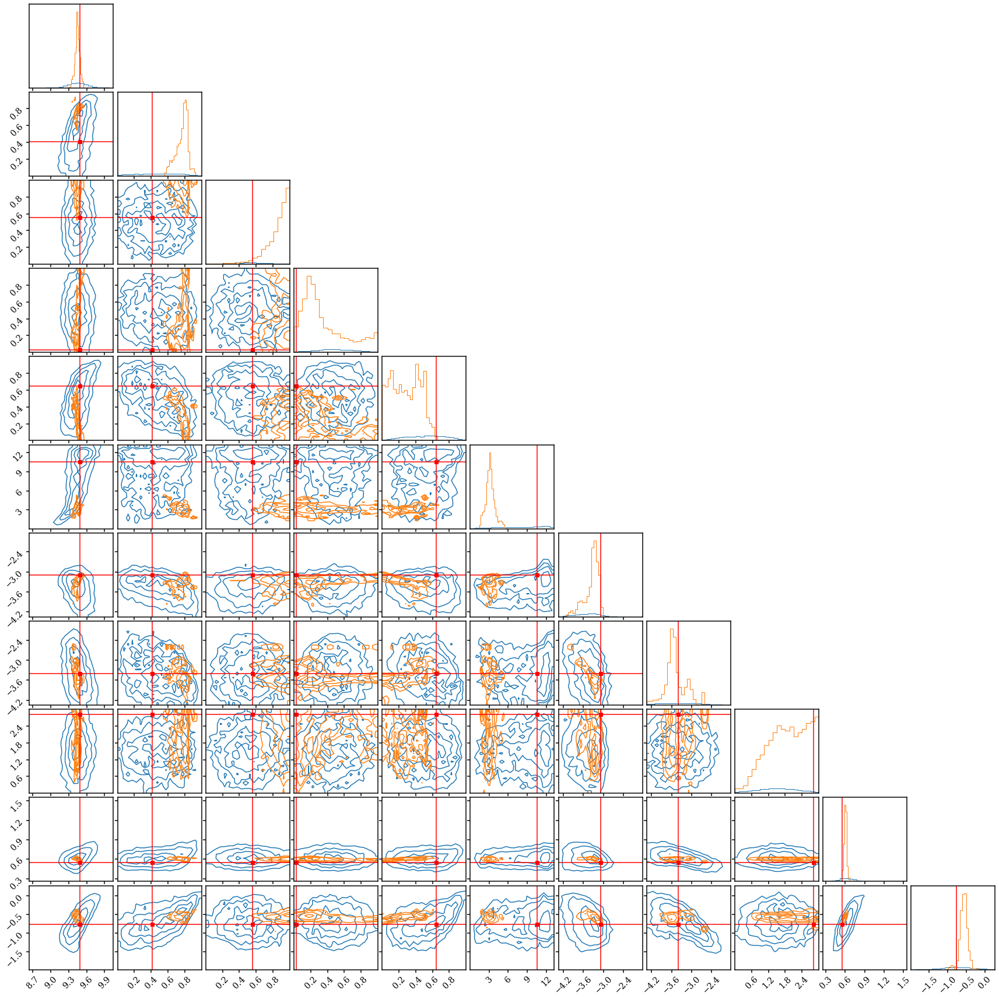

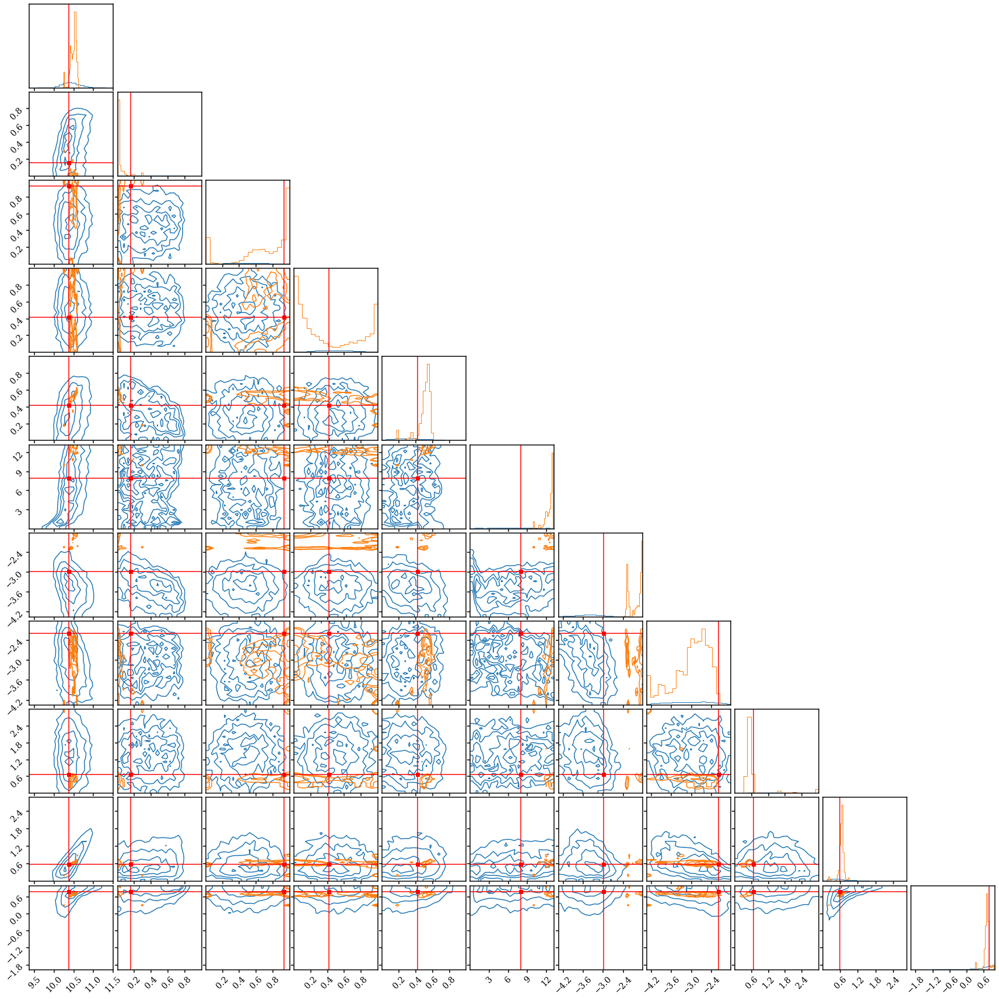

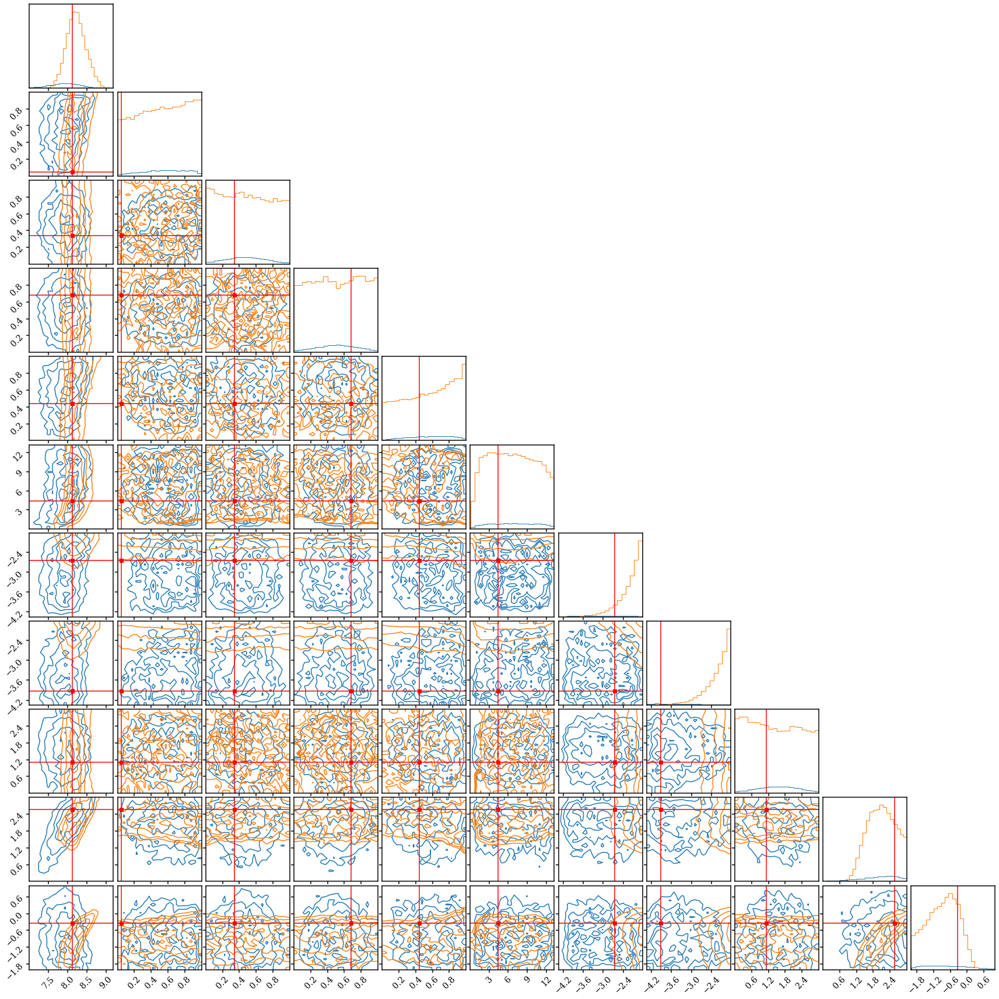

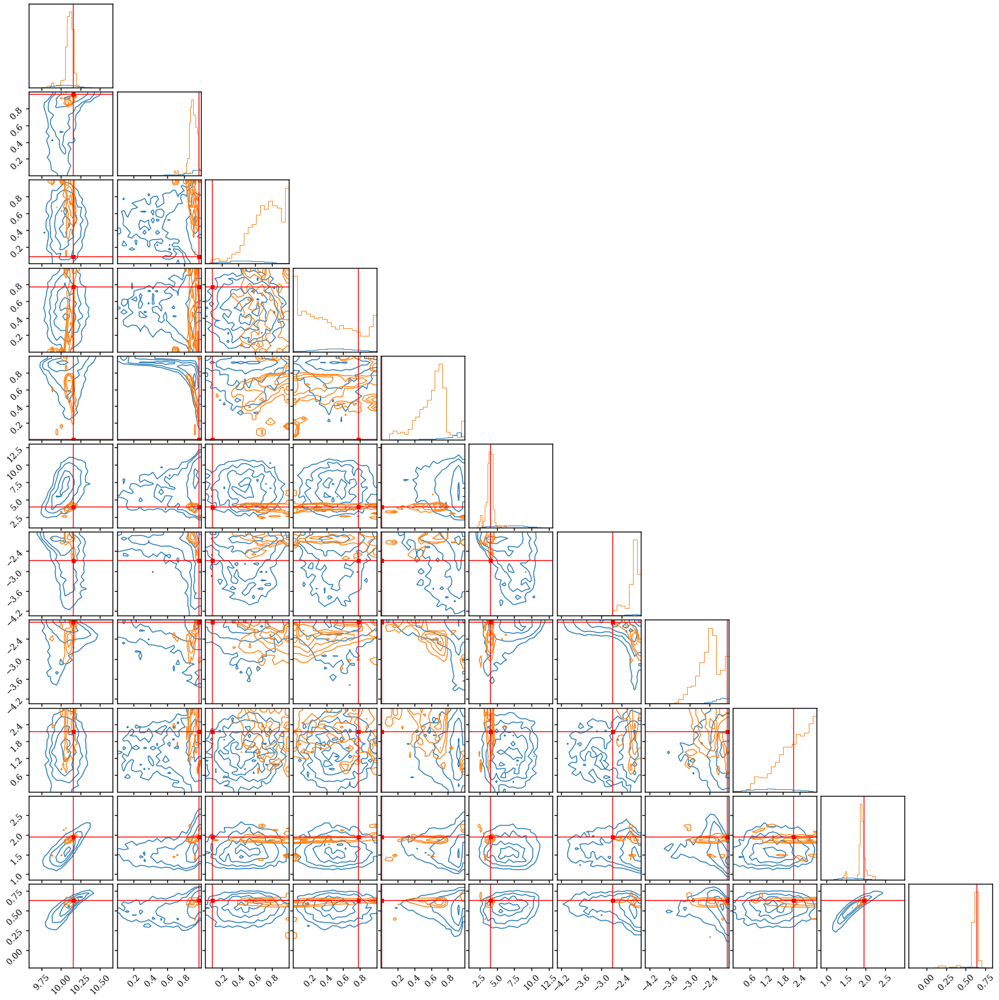

In [58]:
for i_test, _y_test, _x_test in zip(np.arange(test_theta.shape[0])[pos_Aspec][:10], test_theta[pos_Aspec], x_test[pos_Aspec]):
    # sample posterior p(theta | x_test_i)
    mcmc_npe = qphi.sample((10000,),
            x=torch.as_tensor(_x_test.astype(np.float32)).to(device),
            show_progress_bars=False)
    mcmc_npe = np.array(mcmc_npe.detach().to('cpu'))
    
    fmcmc = h5py.File(f'/scratch/network/chhahn/sedflow/mcmc_spectra/mcmc.mock.{i_test}.hdf5', 'r')
    
    _mcmc = fmcmc['mcmc_chain'][...].reshape((fmcmc['mcmc_chain'][...].shape[0]*fmcmc['mcmc_chain'][...].shape[1], fmcmc['mcmc_chain'][...].shape[2]))
    mcmc = prior_sps.untransform(_mcmc)
    mcmc[:,6:8] = np.log10(mcmc[:,6:8])
    
    fig = DFM.corner(mcmc_npe, color='C0', plot_density=False, plot_datapoints=False)
    _ = DFM.corner(mcmc, truths=_y_test, truth_color='r', color='C1', plot_density=False, plot_datapoints=False, fig=fig)
    plt.show()

In [30]:
rank_thetas = [] 
t = trange(1000, leave=False)
for i in t: 
    _x_test = x_test[i]
    _y_test = test_theta[i]
    
    # sample posterior p(theta | x_test_i)
    mcmc_npe = qphi.sample((10000,),
            x=torch.as_tensor(_x_test.astype(np.float32)).to(device),
            show_progress_bars=False)
    mcmc_npe = np.array(mcmc_npe.detach().to('cpu'))
    
    # calculate percentile score and rank
    rank_theta = []
    for itheta in range(11):
        rank_theta.append(np.sum(mcmc_npe[:,itheta] < _y_test[itheta]))
    rank_thetas.append(np.array(rank_theta))
rank_thetas = np.array(rank_thetas)

  0%|          | 0/1000 [00:00<?, ?it/s]

In [31]:
rank_thetas = np.array(rank_thetas)

[]

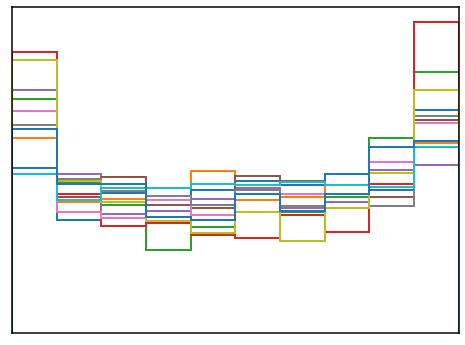

In [37]:
fig = plt.figure(figsize=(8,6))
sub = fig.add_subplot(111)
for i in range(11): 
    _ = sub.hist(rank_thetas[:,i]/10000, range=(0., 1), bins=10, histtype='step', linewidth=2)
sub.set_xlim(0., 1)
sub.set_xticks([])
sub.set_yticks([])